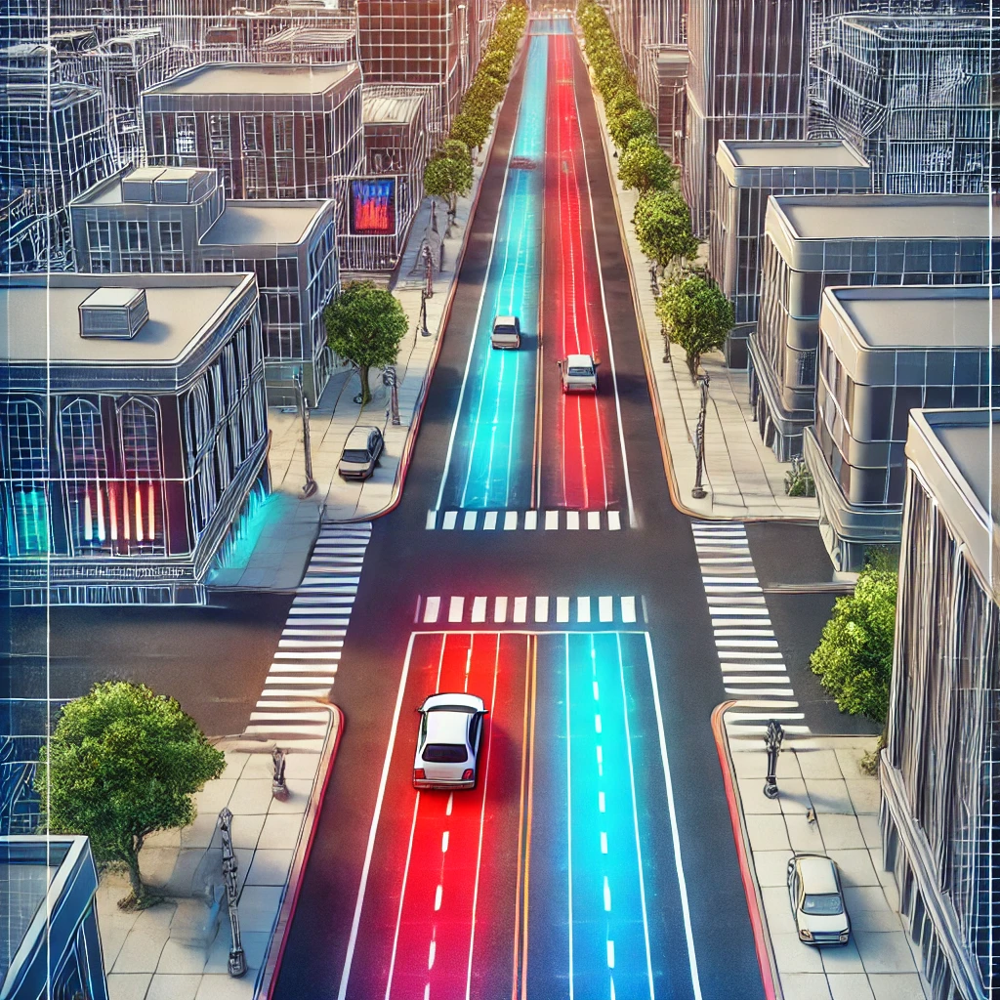

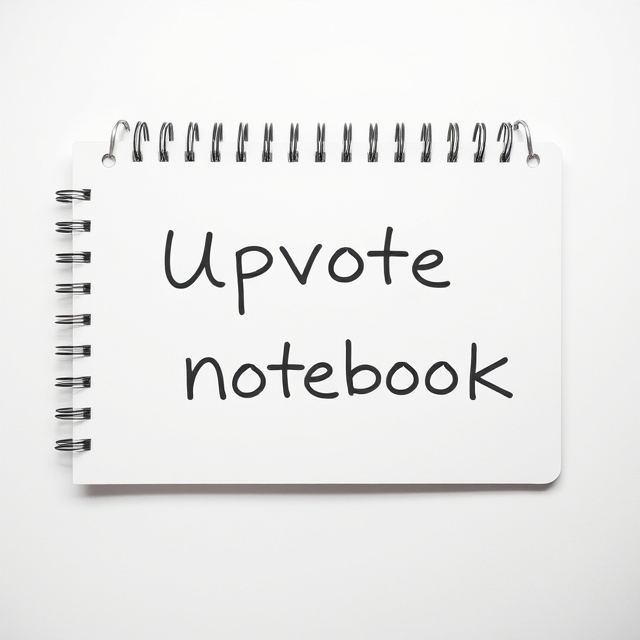

# 1. Import Libraries

In [82]:
import os
import numpy as np
import pandas as pd
import wandb
import yaml
import zipfile
import matplotlib.pyplot as plt
import cv2
from IPython.display import HTML
from matplotlib import animation
from tqdm import tqdm
from PIL import Image
from ultralytics import YOLO
from IPython.display import FileLink

# 2. YAML File

In [83]:
data_yaml = dict(
    train ='/kaggle/working/dataset/train/images',
    val ='/kaggle/working/dataset/val/images',
    test='/kaggle/working/dataset/test/images',
    nc = 1,
    names =['Lane']
)

In [84]:
with open('dataset.yaml', 'w') as outfile:
    yaml.dump(data_yaml, outfile, default_flow_style=True)

# 3. Dataset Import

In [85]:
def create_zip(source_folder, destination_zip):
    with zipfile.ZipFile(destination_zip, 'w', zipfile.ZIP_DEFLATED) as zip_ref:
        for root, dirs, files in os.walk(source_folder):
            for file in files:
                file_path = os.path.join(root, file)
                zip_ref.write(file_path, arcname=os.path.relpath(file_path, source_folder))

In [86]:
def extract_zip(zip_file, destination_folder):
    with zipfile.ZipFile(zip_file, 'r') as zip_ref:
        zip_ref.extractall(destination_folder)

In [87]:
source_folder = '/kaggle/input/road-lane-segmentation-imgs-and-labels'
destination_zip = '/kaggle/working/dataset.zip'
destination_folder = '/kaggle/working/'

create_zip(source_folder, destination_zip)
extract_zip(destination_zip, destination_folder)

# 4. Train

In [88]:
model = YOLO("yolo11m-seg.pt") 

In [89]:
!yolo task=detect mode=train model=yolo11m-seg.pt data=dataset.yaml epochs=25 imgsz=640

WARNING ⚠️ conflicting 'task=detect' passed with 'task=segment' model. Ignoring 'task=detect' and updating to 'task=segment' to match model.
Ultralytics 8.3.49 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=segment, mode=train, model=yolo11m-seg.pt, data=dataset.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False,

In [90]:
!zip -r runs.zip runs/

  adding: runs/ (stored 0%)
  adding: runs/segment/ (stored 0%)
  adding: runs/segment/train/ (stored 0%)
  adding: runs/segment/train/MaskP_curve.png (deflated 29%)
  adding: runs/segment/train/BoxP_curve.png (deflated 29%)
  adding: runs/segment/train/events.out.tfevents.1733943809.5a18821c6c5b.832.0 (deflated 93%)
  adding: runs/segment/train/results.png (deflated 8%)
  adding: runs/segment/train/train_batch2.jpg (deflated 2%)
  adding: runs/segment/train/val_batch2_pred.jpg (deflated 6%)
  adding: runs/segment/train/results.csv (deflated 62%)
  adding: runs/segment/train/val_batch0_labels.jpg (deflated 7%)
  adding: runs/segment/train/BoxPR_curve.png (deflated 30%)
  adding: runs/segment/train/args.yaml (deflated 53%)
  adding: runs/segment/train/MaskPR_curve.png (deflated 30%)
  adding: runs/segment/train/val_batch2_labels.jpg (deflated 6%)
  adding: runs/segment/train/val_batch1_pred.jpg (deflated 6%)
  adding: runs/segment/train/val_batch0_pred.jpg (deflated 7%)
  adding: runs/s

In [91]:
FileLink('runs.zip')

/kaggle/working/runs.zip

# 5. Results

In [92]:
def display_training_results(directory, file_extension=('.jpg', '.png'), images_per_row=2, image_height=10):
    image_paths = []
    
    for dirname, _, filenames in os.walk(directory):
        for filename in filenames:
            if filename.endswith(file_extension):
                image_paths.append(os.path.join(dirname, filename))

    num_images = len(image_paths)
    num_rows = (num_images + images_per_row - 1) // images_per_row  
    figsize = (images_per_row * image_height, num_rows * image_height)
    fig, axes = plt.subplots(num_rows, images_per_row, figsize=figsize)
    axes = axes.flatten() 

    for i, path in enumerate(image_paths):
        image = Image.open(path)
        axes[i].imshow(np.array(image))
        axes[i].axis('off') 

    for j in range(len(image_paths), len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

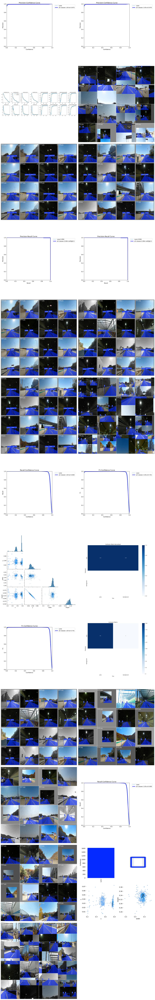

In [93]:
display_training_results('/kaggle/working/runs/segment/train')

# 6. Predict

In [94]:
model = YOLO("runs/segment/train/weights/best.pt") 

In [95]:
def process_and_plot_results(test_folder):
    image_files = [f for f in os.listdir(test_folder) if f.endswith(('.jpg', '.jpeg', '.png'))]

    random_files = random.sample(image_files, min(10, len(image_files)))
    
    for filename in random_files:
        file_path = os.path.join(test_folder, filename)
        
        if filename.endswith(('.jpg', '.jpeg', '.png')):
            image = cv2.imread(file_path)
            image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            yolo_classes = list(model.names.values())
            classes_ids = [yolo_classes.index(clas) for clas in yolo_classes]
            conf = 0.5
            results = model.predict(image, conf=conf)
            colors = [255, 0, 0]

            for result in results:
                for mask, box in zip(result.masks.xy, result.boxes):
                    points = np.int32([mask])
                    color_number = classes_ids.index(int(box.cls[0]))
                    cv2.fillPoly(image_rgb, points, colors[color_number])

            plt.figure(figsize=(8, 6))
            plt.imshow(image_rgb)
            plt.title(f"Image: {filename}")
            plt.axis("off")
            plt.show()


0: 640x640 2 Lanes, 22.1ms
Speed: 1.8ms preprocess, 22.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


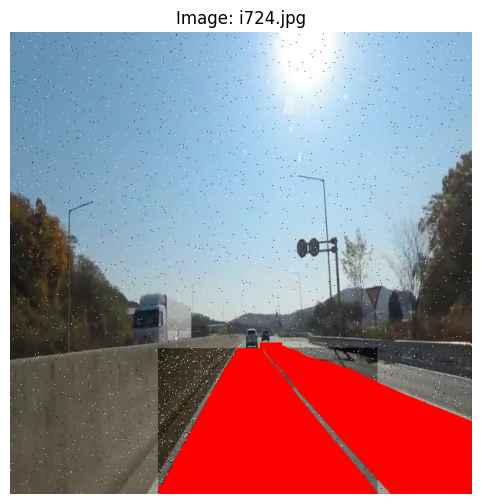


0: 640x640 2 Lanes, 22.2ms
Speed: 1.8ms preprocess, 22.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


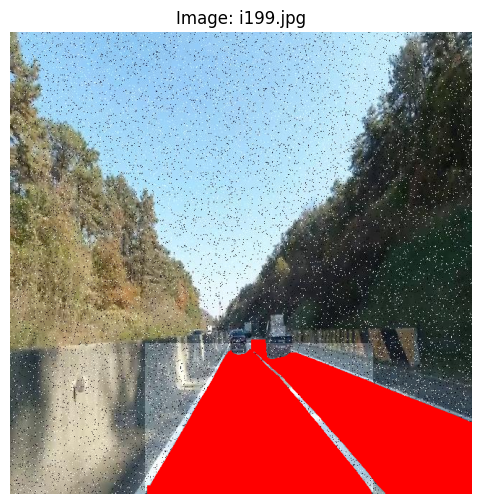


0: 640x640 2 Lanes, 22.2ms
Speed: 2.2ms preprocess, 22.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


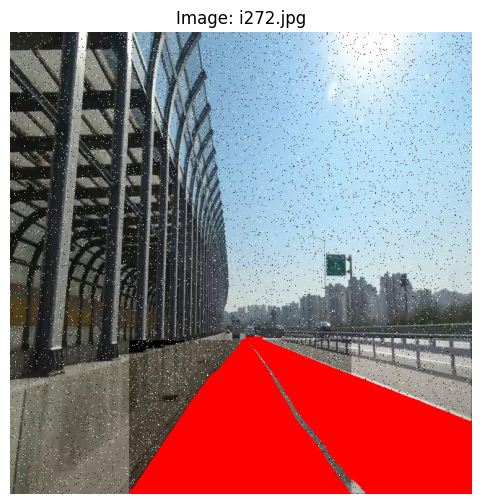


0: 640x640 2 Lanes, 22.3ms
Speed: 1.7ms preprocess, 22.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


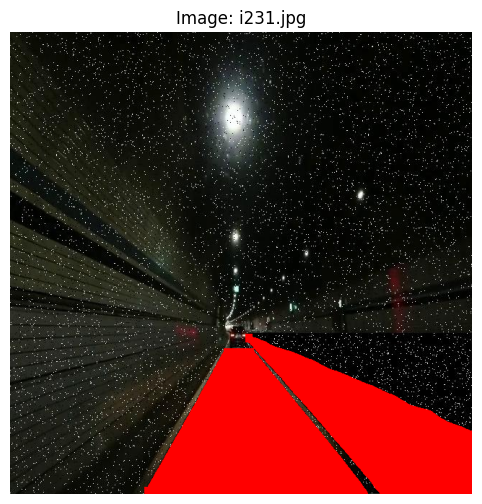


0: 640x640 2 Lanes, 22.2ms
Speed: 1.8ms preprocess, 22.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


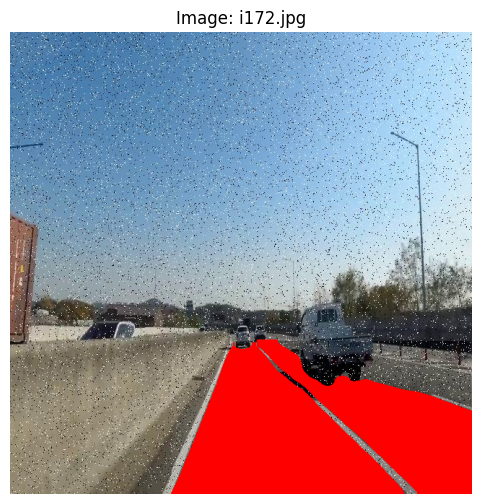


0: 640x640 2 Lanes, 22.3ms
Speed: 2.2ms preprocess, 22.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


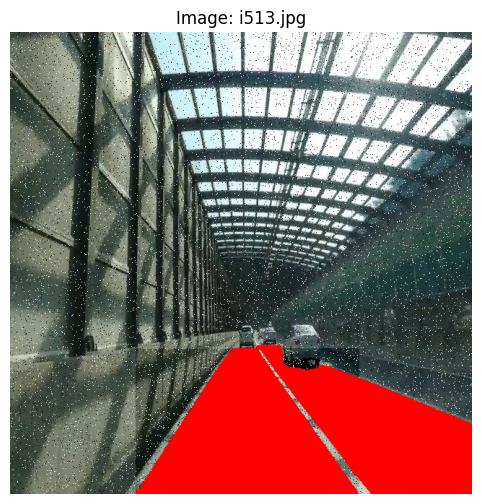


0: 640x640 2 Lanes, 22.2ms
Speed: 1.8ms preprocess, 22.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


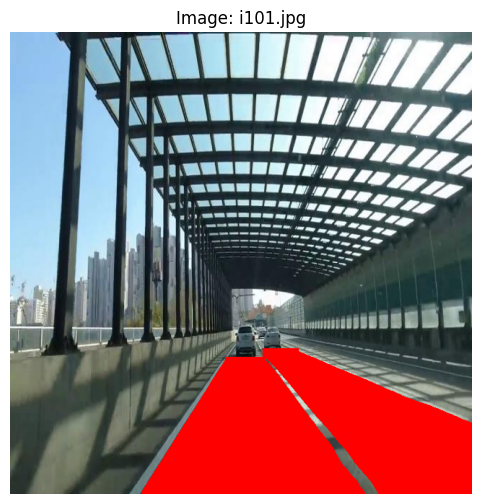


0: 640x640 2 Lanes, 22.2ms
Speed: 1.6ms preprocess, 22.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


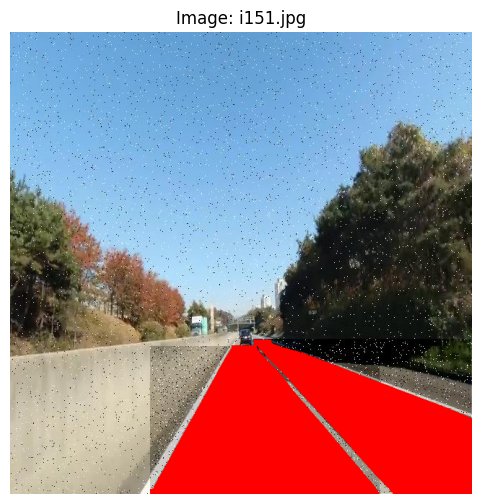


0: 640x640 2 Lanes, 22.3ms
Speed: 2.3ms preprocess, 22.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


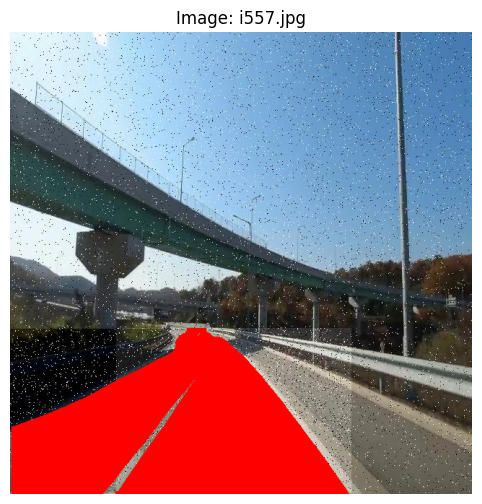


0: 640x640 2 Lanes, 22.2ms
Speed: 2.3ms preprocess, 22.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


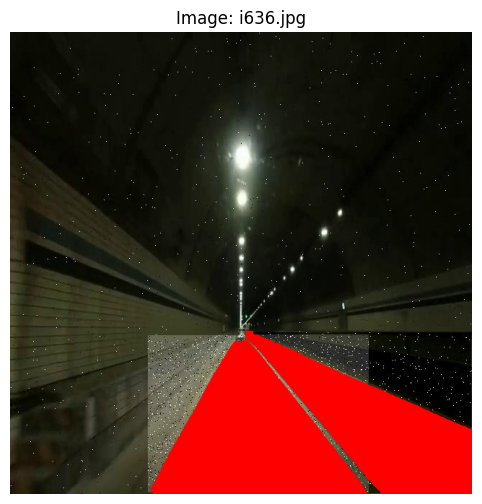

In [96]:
test_folder_path = "dataset/test/images" 
process_and_plot_results(test_folder_path)